In [1]:
import pandas as pd

# Load the CSV file into a DataFrame
df = pd.read_csv('202410-baywheels-tripdata.csv')

# Display the first few rows of the DataFrame
df.head()

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
0,D09B7E8A1EA339B2,classic_bike,2024-10-09 15:29:05.916,2024-10-09 15:32:12.390,Telegraph Ave at 27th St,OK-I5,Broadway at 30th St,OK-H5,37.816073,-122.267886,37.819381,-122.261928,member
1,093B5DE9161582AA,electric_bike,2024-10-27 01:34:27.996,2024-10-27 01:57:30.668,Adeline St at 40th St,EM-D4,23rd Ave at Foothill Blvd,OK-L14,37.831277,-122.278267,37.785192,-122.234382,member
2,C69686060E24DC12,classic_bike,2024-10-14 08:37:26.870,2024-10-14 09:04:11.726,San Pablo Park,BK-G4,45th St at Manila,OK-E5,37.855783,-122.283127,37.833294,-122.256224,member
3,035C62A91F6600EA,electric_bike,2024-10-26 16:20:24.481,2024-10-26 16:29:49.607,San Pablo Park,BK-G4,Fifth St at Delaware St,BK-C1,37.855783,-122.283127,37.870407,-122.299676,casual
4,210828D771126B82,classic_bike,2024-10-17 21:26:49.861,2024-10-17 21:29:19.333,4th St at Mission Bay Blvd S,SF-L30-1,Berry St at 4th St,SF-K29-1,37.770314,-122.391237,37.775993,-122.393006,member


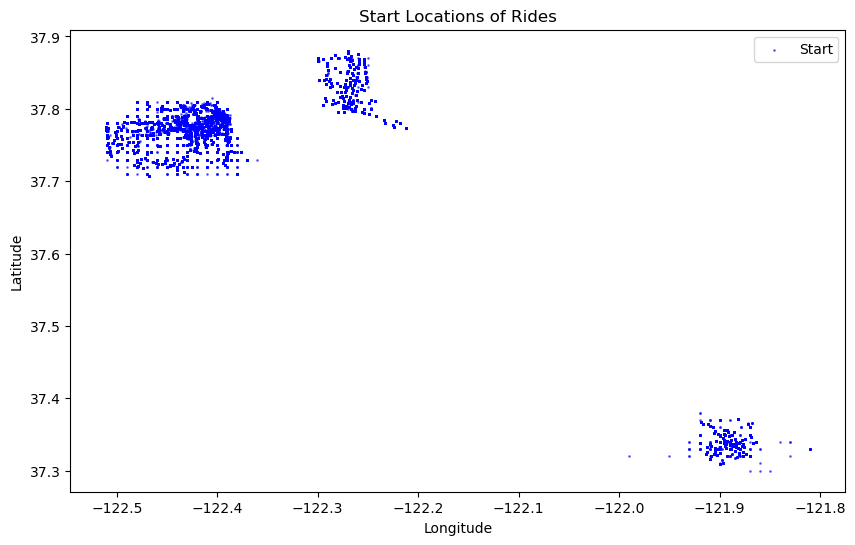

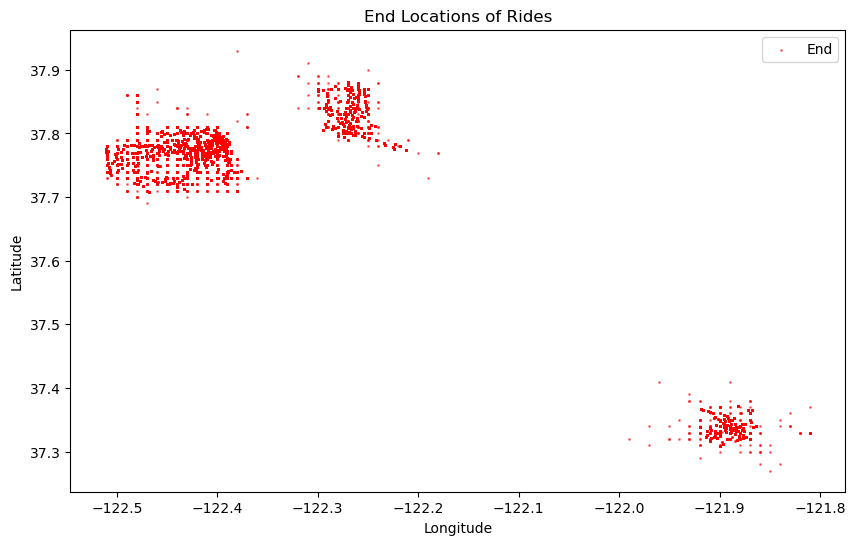

In [2]:
import matplotlib.pyplot as plt

# Plot the start coordinates
plt.figure(figsize=(10, 6))
plt.scatter(df['start_lng'], df['start_lat'], c='blue', label='Start', alpha=0.5, s=1)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Start Locations of Rides')
plt.legend()
plt.show()

# Plot the end coordinates
plt.figure(figsize=(10, 6))
plt.scatter(df['end_lng'], df['end_lat'], c='red', label='End', alpha=0.5, s=1)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('End Locations of Rides')
plt.legend()
plt.show()
# Remove rows with NaN values in the relevant columns
df_clean = df.dropna(subset=['start_lat', 'start_lng', 'end_lat', 'end_lng'])

# Calculate the center of the map
map_center = [df_clean['start_lat'].mean(), df_clean['start_lng'].mean()]

import plotly.express as px

# Plot start locations on a map
fig_start = px.scatter_mapbox(df_clean, lat='start_lat', lon='start_lng', color_discrete_sequence=['blue'], 
                              title='Start Locations of Rides', zoom=10, height=600)
fig_start.update_layout(mapbox_style="open-street-map", mapbox_zoom=10, mapbox_center={"lat": map_center[0], "lon": map_center[1]})
fig_start.show()

# Plot end locations on a map
fig_end = px.scatter_mapbox(df_clean, lat='end_lat', lon='end_lng', color_discrete_sequence=['red'], 
                            title='End Locations of Rides', zoom=10, height=600)
fig_end.update_layout(mapbox_style="open-street-map", mapbox_zoom=10, mapbox_center={"lat": map_center[0], "lon": map_center[1]})
fig_end.show()